# RSNA Pneumonia Detection Challenge

for more detail, please visit:
https://www.kaggle.com/c/rsna-pneumonia-detection-challenge

# Data exploration

In [31]:
import glob
import pydicom as dcm
import numpy as np
import pandas as pd
import pylab
import matplotlib.pyplot as plt
import os
IS_LOCAL = False
if(IS_LOCAL):
    PATH="data/rsna-pneumonia-detection-challenge"
else:
    PATH="data"
print(os.listdir(PATH))

%matplotlib inline
# np.warnings.filterwarnings('ignore')

['GCP Credits Request Link - RSNA.txt', 'stage_1_detailed_class_info.csv', 'stage_1_sample_submission.csv', 'stage_1_test_images', 'stage_1_train_images', 'stage_1_train_labels.csv']


### Parsing Tabular Data:

In [2]:
labels = pd.read_csv('data/stage_1_train_labels.csv')
details = pd.read_csv('data/stage_1_detailed_class_info.csv')
# duplicates in details just have the same class so can be safely dropped
details = details.drop_duplicates('patientId').reset_index(drop=True)
labels_w_class = labels.merge(details, how='inner', on='patientId')

In [13]:
labels_w_class.head()

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity


In [14]:
labels_w_class.describe()

,x,y,width,height,Target
count,8964.000000,8964.000000,8964.000000,8964.000000,28989.000000
mean,391.456158,363.135877,220.845382,334.174364,0.309221
std,203.945378,148.607149,59.041384,158.097239,0.462180
min,2.000000,2.000000,40.000000,45.000000,0.000000
25%,205.000000,246.000000,180.000000,207.000000,0.000000
50%,320.000000,360.000000,219.000000,304.000000,0.000000
75%,591.000000,475.000000,261.000000,445.000000,1.000000
max,817.000000,881.000000,528.000000,942.000000,1.000000


In [74]:
# to see how many unique patients
len(labels_w_class['patientId'].unique())

25684

### Parsing Metadata from DICOM Object:

In [15]:
# get lists of all train/test dicom filepaths
train_dcm_fps = glob.glob('data/stage_1_train_images/*.dcm')
test_dcm_fps = glob.glob('data/stage_1_test_images/*.dcm')

# read each file into a list (using stop_before_pixels to avoid reading the image for speed and memory savings)
train_dcms = [dcm.read_file(x, stop_before_pixels=True) for x in train_dcm_fps]
test_dcms = [dcm.read_file(x, stop_before_pixels=True) for x in test_dcm_fps]

In [72]:
train_dcms[0]

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time                          TM: '000000.00'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'CR'
(0008, 0064) Conversion Type                     CS: 'WSD'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 103e) Series Description                  LO: 'view: PA'
(0010, 0010) Patient's Name                      PN: '0004cfab-14fd-4e49-80ba-63a80b6bddd6'
(0010, 0020) Patient ID                          LO: '0004cfab-14fd-4e49-80ba-63a80b6bddd6'
(0010, 0030) Patient's Birth Date                DA: ''
(0010, 0040) Patient's Sex                       CS: 'F'
(0010, 1010) Patient'

We have quite a bit of additional data in the DICOM header we can easily extract to help learn more about the patient like their age, view position and gender which can make the model much more precise

In [90]:
def parse_dcm_metadata(dcm):
    unpacked_data = {}
    group_elem_to_keywords = {}
    # iterating here to force conversion from lazy RawDataElement to DataElement
    for d in dcm:
        pass
    # keys are pydicom.tag.BaseTag, values are pydicom.dataelem.DataElement
    for tag, elem in dcm.items():
        tag_group = tag.group
        tag_elem = tag.elem
        keyword = elem.keyword
        group_elem_to_keywords[(tag_group, tag_elem)] = keyword
        value = elem.value
        unpacked_data[keyword] = value
    return unpacked_data, group_elem_to_keywords

train_meta_dicts, tag_to_keyword_train = zip(*[parse_dcm_metadata(x) for x in train_dcms])
test_meta_dicts, tag_to_keyword_test = zip(*[parse_dcm_metadata(x) for x in test_dcms])

In [91]:
# join all the dicts
unified_tag_to_key_train = {k:v for dict_ in tag_to_keyword_train for k,v in dict_.items()}
unified_tag_to_key_test = {k:v for dict_ in tag_to_keyword_test for k,v in dict_.items()}

# quick check to make sure there are no different keys between test/train
assert len(set(unified_tag_to_key_test.keys()).symmetric_difference(set(unified_tag_to_key_train.keys()))) == 0

tag_to_key = {**unified_tag_to_key_test, **unified_tag_to_key_train}

In [92]:
# using from_records here since some values in the dicts will be iterables and some are constants
train_df = pd.DataFrame.from_records(data=train_meta_dicts)
test_df = pd.DataFrame.from_records(data=test_meta_dicts)
train_df['dataset'] = 'train'
test_df['dataset'] = 'test'
df = pd.concat([train_df, test_df])

In [93]:
df.head()

,AccessionNumber,BitsAllocated,BitsStored,BodyPartExamined,Columns,ConversionType,HighBit,InstanceNumber,LossyImageCompression,LossyImageCompressionMethod,...,SeriesDescription,SeriesInstanceUID,SeriesNumber,SpecificCharacterSet,StudyDate,StudyID,StudyInstanceUID,StudyTime,ViewPosition,dataset
0,,8,8,CHEST,1024,WSD,7,1,01,ISO_10918_1,...,view: PA,1.2.276.0.7230010.3.1.3.8323329.28530.15178744...,1,ISO_IR 100,19010101,,1.2.276.0.7230010.3.1.2.8323329.28530.15178744...,000000.00,PA,train
1,,8,8,CHEST,1024,WSD,7,1,01,ISO_10918_1,...,view: PA,1.2.276.0.7230010.3.1.3.8323329.26024.15178744...,1,ISO_IR 100,19010101,,1.2.276.0.7230010.3.1.2.8323329.26024.15178744...,000000.00,PA,train
2,,8,8,CHEST,1024,WSD,7,1,01,ISO_10918_1,...,view: AP,1.2.276.0.7230010.3.1.3.8323329.11252.15178743...,1,ISO_IR 100,19010101,,1.2.276.0.7230010.3.1.2.8323329.11252.15178743...,000000.00,AP,train
3,,8,8,CHEST,1024,WSD,7,1,01,ISO_10918_1,...,view: PA,1.2.276.0.7230010.3.1.3.8323329.2293.151787429...,1,ISO_IR 100,19010101,,1.2.276.0.7230010.3.1.2.8323329.2293.151787429...,000000.00,PA,train
4,,8,8,CHEST,1024,WSD,7,1,01,ISO_10918_1,...,view: AP,1.2.276.0.7230010.3.1.3.8323329.6379.151787432...,1,ISO_IR 100,19010101,,1.2.276.0.7230010.3.1.2.8323329.6379.151787432...,000000.00,AP,train


### Play around with Train metadata:

In [137]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25684 entries, 0 to 25683
Data columns (total 35 columns):
AccessionNumber                25684 non-null object
BitsAllocated                  25684 non-null int64
BitsStored                     25684 non-null int64
BodyPartExamined               25684 non-null object
Columns                        25684 non-null int64
ConversionType                 25684 non-null object
HighBit                        25684 non-null int64
InstanceNumber                 25684 non-null int64
LossyImageCompression          25684 non-null object
LossyImageCompressionMethod    25684 non-null object
Modality                       25684 non-null object
PatientAge                     25684 non-null object
PatientBirthDate               25684 non-null object
PatientID                      25684 non-null object
PatientName                    25684 non-null object
PatientOrientation             25684 non-null object
PatientSex                     25684 non-null ob

In [158]:
for i in range(len(train_df.columns)):
    if train_df.columns[i]!='PixelSpacing':
        count=train_df[(train_df.columns[i])].nunique()
        print (train_df.columns[i], count)

AccessionNumber 1
BitsAllocated 1
BitsStored 1
BodyPartExamined 1
Columns 1
ConversionType 1
HighBit 1
InstanceNumber 1
LossyImageCompression 1
LossyImageCompressionMethod 1
Modality 1
PatientAge 97
PatientBirthDate 1
PatientID 25684
PatientName 25684
PatientOrientation 1
PatientSex 2
PhotometricInterpretation 1
PixelRepresentation 1
ReferringPhysicianName 8655
Rows 1
SOPClassUID 1
SOPInstanceUID 25684
SamplesPerPixel 1
SeriesDescription 2
SeriesInstanceUID 25684
SeriesNumber 1
SpecificCharacterSet 1
StudyDate 1
StudyID 1
StudyInstanceUID 25684
StudyTime 1
ViewPosition 2
dataset 1


#### The stats above indicates the only possible feature are PatientAge, PatientSex, PixelSpacing, and ViewPosition

In [172]:
train_df_new=train_df[['PatientID','PatientAge','PatientSex','ViewPosition']]
train_df_new['PixelSpacing_x'] = train_df['PixelSpacing'].apply(lambda x: x[0])
train_df_new.head(10)

C:\Users\suh10\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,PatientID,PatientAge,PatientSex,ViewPosition,PixelSpacing_x
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,51,F,PA,0.143000
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,48,F,PA,0.194311
2,00322d4d-1c29-4943-afc9-b6754be640eb,19,M,AP,0.168000
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,28,M,PA,0.143000
4,00436515-870c-4b36-a041-de91049b9ab4,32,F,AP,0.139000
5,00569f44-917d-4c86-a842-81832af98c30,54,M,AP,0.139000
6,006cec2e-6ce2-4549-bffa-eadfcd1e9970,78,M,PA,0.143000
7,00704310-78a8-4b38-8475-49f4573b2dbb,75,M,PA,0.143000
8,008c19e8-a820-403a-930a-bc74a4053664,59,F,PA,0.194311
9,009482dc-3db5-48d4-8580-5c89c4f01334,63,M,PA,0.143000


In [173]:
train_df_new.shape

(25684, 5)

In [174]:
# merge clean metadata with our initial tabular data
df_partial = train_df_new.merge(labels_w_class[['patientId','Target','class']], how='left', left_on='PatientID', right_on='patientId')
df_partial['PatientAge'] = df_partial['PatientAge'].astype(int)
df_all=

,PatientID,PatientAge,PatientSex,ViewPosition,PixelSpacing_x,patientId,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,51,F,PA,0.143000,0004cfab-14fd-4e49-80ba-63a80b6bddd6,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,48,F,PA,0.194311,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,19,M,AP,0.168000,00322d4d-1c29-4943-afc9-b6754be640eb,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,28,M,PA,0.143000,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,32,F,AP,0.139000,00436515-870c-4b36-a041-de91049b9ab4,1,Lung Opacity


### Discussion about View Position:

** View Position is likely important since it describes the positioning of the patient when the radiograph is taken. PA = posterior-anterior (ray enters back first, so back would be at the 'top' of the image) and AP = anterior-posterior (ray enters chest first). My understanding is that AP would be the desired position for detecting lung opacity, however it frequently can't be done in that way as the patient is too ill to stand (which is required for PA). I think there are several important elements here: the pose of the patient is different (standing vs laying), the image has a different 'view' (back-first vs chest-first) and as such different parts of the body may be occluded or obscured to an extent, image quality itself is probably better in AP. **

### Some takeaways by other ppl:
* Test/Train seems relatively well balanced AP vs PA
* AP vs PA have a big shift in the 'Normal' and 'Lung Opacity' classes
* Target 1/0 is well split for AP, but for PA there are many more 0s
* Gender seems relatively well balanced AP vs PA
* Age distributions seem similar AP vs PA
* Different pixel spacing AP vs PA (probably due to different location of patient relative to imaging machine)

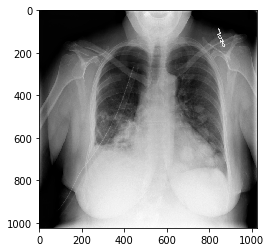

In [28]:
# dcm.filereader.read_partial
# dcm.dcmread?
dcm_data = dcm.read_file(train_dcm_fps[0])
im=dcm_data.pixel_array
# im=train_dcms[0].pixel_array
pylab.imshow(im, cmap=pylab.cm.gist_gray)

In [24]:
pylab.test_dcm_fps

### Plot DICOM images with Target = 1

In [46]:
def show_dicom_images(data):
#     img_data = list(data[:9].T.to_dict().values())
    img_data = list(data[:180].T.to_dict().values())
    f, ax = plt.subplots(60,3, figsize=(18,360))
    for i,data_row in enumerate(img_data):
        patientImage = data_row['patientId']+'.dcm'
        imagePath = os.path.join(PATH,"stage_1_train_images/",patientImage)
        data_row_img_data = dcm.read_file(imagePath)
        modality = data_row_img_data.Modality
        age = data_row_img_data.PatientAge
        sex = data_row_img_data.PatientSex
        data_row_img = dcm.dcmread(imagePath)
        ax[i//3, i%3].imshow(data_row_img.pixel_array, cmap=plt.cm.bone) 
        ax[i//3, i%3].axis('off')
#         ax[i//3, i%3].set_title('ID: {}\nModality: {} Age: {} Sex: {} Target: {}\nClass: {}\nWindow: {}:{}:{}:{}'.format(
#                 data_row['patientId'],
#                 modality, age, sex, data_row['Target'], data_row['class'], 
#                 data_row['x'],data_row['y'],data_row['width'],data_row['height']))
    plt.show()

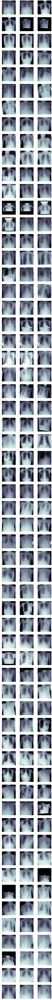

In [47]:
show_dicom_images(labels_w_class[labels_w_class['Target']==1])

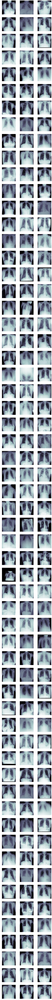

In [48]:
show_dicom_images(labels_w_class[labels_w_class['Target']==0])